### Vizualizace vybraných signálů po časovém zarovnání

V rámci experimentální části byla provedena čtyři měření s různými scénáři jízdního chování označená jako **FUN**, **RUN**, **BUS** a **Braking**.  

Pro účely společné analýzy, modelování a vizualizace bylo nutné data **časově zarovnat a převzorkovat** na jednotnou časovou osu. Tento krok byl proveden pomocí skriptu, který pro každý signál provedl **lineární interpolaci** (`numpy.interp`)  
na společný časový vektor s krokem **Δt = 0,01 s**, frekvenci **100 Hz**.  

Pro vizualizaci byly z těchto zarovnaných dat vybrány klíčové signály popisující pohyb vozidla:
- **`sigLAC_AP_Position`** – poloha aktuátoru akceleračního pedálu ovládaného regulátorem [**%**],  
- **`sigLAC_BP_Position`** – poloha aktuátoru brzdového pedálu ovládaného regulátorem [**%**],  
- **`wheel_based_vehicle_speed`** – rychlost vozidla založená na údajích z kol [**km/h**],  
- **`Longitudinal_acceleration`** – podélné zrychlení vozidla [**m/s²**].

📂 Found 10 aligned traces


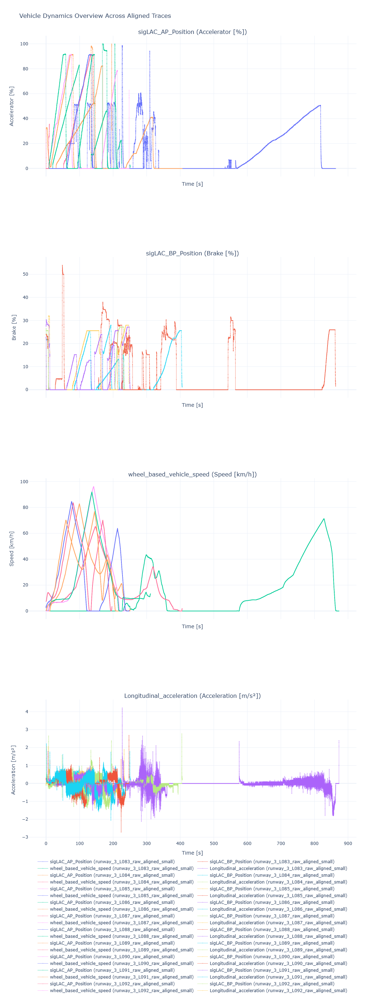

In [1]:
# visualize_aligned_traces_plotly.py
import numpy as np
import plotly.graph_objects as go
from pathlib import Path

# --- CONFIG ---
ALIGNED_DIR = Path(r"C:\Users\LV098\Documents\Documents\DIP\260825\Processed_data\Aligned_RUN_npz")

# Signals + units (for axis labels)
signals_to_plot = {
    "sigLAC_AP_Position": "Accelerator [%]",
    "sigLAC_BP_Position": "Brake [%]",
    "wheel_based_vehicle_speed": "Speed [km/h]",
    "Longitudinal_acceleration": "Acceleration [m/s²]",
}

# --- LOAD ALL FILES ---

aligned_files = sorted(ALIGNED_DIR.glob("*_aligned_small.npz"))
print(f"📂 Found {len(aligned_files)} aligned traces")

if not aligned_files:
    raise FileNotFoundError("No aligned traces found in the directory!")

# --- CREATE SUBPLOTS ---
from plotly.subplots import make_subplots

fig = make_subplots(
    rows=len(signals_to_plot),
    cols=1,
    shared_xaxes=True,
    vertical_spacing=0.1,
    subplot_titles=[f"{sig} ({unit})" for sig, unit in signals_to_plot.items()]
)

# --- ADD TRACES ---
for file_path in aligned_files:
    data = np.load(file_path, allow_pickle=True)
    t = data["time"].flatten()
    t = t - t[0]  # normalize time to start at 0

    for i, (sig, unit) in enumerate(signals_to_plot.items(), start=1):
        if sig not in data:
            continue

        y = data[sig].astype(float).flatten()


        fig.add_trace(
            go.Scattergl(
                x=t,
                y=y,
                mode="lines+markers",
                marker=dict(size=2),
                name=f"{sig} ({file_path.stem})",
                line=dict(width=1),
                opacity=0.6,
            ),
            row=i, col=1
        )

# --- STYLING ---
fig.update_layout(
    title="Vehicle Dynamics Overview Across Aligned Traces",
    height=2800,
    hovermode="x unified",
    legend=dict(orientation="h", yanchor="bottom", y=-3.5, xanchor="center", x=0.5),
    template="plotly_white",
)

fig.update_xaxes(title_text="Time [s]", showgrid=True)
for i, (sig, unit) in enumerate(signals_to_plot.items(), start=1):
    fig.update_yaxes(title_text=unit, row=i, col=1, showgrid=True)

fig.show()
